In [1]:
pip install gensim

In [2]:
import json
from collections import Counter
from gensim.models import Word2Vec
import matplotlib.pyplot as plt
import utils




ModuleNotFoundError: ignored

In [3]:
from google.colab import files
files.upload()

Saving countries.json to countries.json


{'countries.json': b'{"Afghanistan": ["Afghanistan", "listen", "Pashto", "Dari", "\\u0627\\u0641\\u063a\\u0627\\u0646\\u0633\\u062a\\u0627\\u0646", "Pashto", "Af\\u0121\\u0101nist\\u0101n", "av\\u0263\\u0252nis\\u02c8t\\u0252n", "ab", "Dari", "Af\\u0121\\u0101nest\\u0101n", "av\\u0263\\u0252nes\\u02c8t\\u0252n", "officially", "the", "Islamic", "Republic", "of", "Afghanistan", "is", "a", "mountainous", "landlocked", "country", "at", "the", "crossroads", "of", "Central", "and", "South", "Asia", "Afghanistan", "is", "bordered", "by", "Pakistan", "to", "the", "east", "and", "south", "Iran", "to", "the", "west", "Turkmenistan", "Uzbekistan", "and", "Tajikistan", "to", "the", "north", "and", "China", "to", "the", "northeast", "Occupying", "652", "000", "square", "kilometers", "252", "000", "sq", "mi", "it", "is", "a", "mountainous", "country", "with", "plains", "in", "the", "north", "and", "southwest", "Kabul", "is", "the", "capital", "and", "largest", "city", "Its", "population", "is", "aro

In [4]:
with open('countries.json', 'r') as fout:
    countries = json.load(fout)

In [5]:
countries['Brazil'][:30]

['Brazil',
 'Portuguese',
 'Brasil',
 'Brazilian',
 'Portuguese',
 'bɾaˈziw',
 'officially',
 'the',
 'Federative',
 'Republic',
 'of',
 'Brazil',
 'is',
 'the',
 'largest',
 'country',
 'in',
 'both',
 'South',
 'America',
 'and',
 'Latin',
 'America',
 'It',
 'covers',
 'an',
 'area',
 'of',
 '8',
 '515']

In [6]:
print(' '.join(countries['India'])[:500]+'...')

India Hindi Bhārat officially the Republic of India Hindi Bhārat Gaṇarājya is a country in South Asia It is the second most populous country the seventh largest country by land area and the most populous democracy in the world Bounded by the Indian Ocean on the south the Arabian Sea on the southwest and the Bay of Bengal on the southeast it shares land borders with Pakistan to the west China Nepal and Bhutan to the north and Bangladesh and Myanmar to the east In the Indian Ocean India is in the ...


In [7]:
for i,(country,text) in enumerate(countries.items()):
  print(country)
  print(' '.join(countries['India'])[:500]+'...')
  print('-' * 100)
  if i >= 5:
    break

Afghanistan
India Hindi Bhārat officially the Republic of India Hindi Bhārat Gaṇarājya is a country in South Asia It is the second most populous country the seventh largest country by land area and the most populous democracy in the world Bounded by the Indian Ocean on the south the Arabian Sea on the southwest and the Bay of Bengal on the southeast it shares land borders with Pakistan to the west China Nepal and Bhutan to the north and Bangladesh and Myanmar to the east In the Indian Ocean India is in the ...
----------------------------------------------------------------------------------------------------
Albania
India Hindi Bhārat officially the Republic of India Hindi Bhārat Gaṇarājya is a country in South Asia It is the second most populous country the seventh largest country by land area and the most populous democracy in the world Bounded by the Indian Ocean on the south the Arabian Sea on the southwest and the Bay of Bengal on the southeast it shares land borders with Pakista

In [8]:
model = Word2Vec(sentences=countries.values())

In [9]:
model.wv.most_similar('India',topn=5)

[('Brazil', 0.829127311706543),
 ('Iran', 0.8173090219497681),
 ('China', 0.8093782067298889),
 ('Russia', 0.7754007577896118),
 ('Mozambique', 0.7700238823890686)]

In [10]:
model =Word2Vec(
    sentences=countries.values(),
    compute_loss=True
)
model.get_latest_training_loss()

5123315.5

In [11]:
counter = Counter()
for words in countries.values():
  for word in words:
    counter.update([word])
print(len(counter))

85125


In [12]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import numpy as np
import matplotlib.pyplot as plt
from gensim.models.callbacks import CallbackAny2Vec
from gensim.models import Word2Vec, KeyedVectors
from tensorflow.keras.layers import Embedding


class MetricCallback(CallbackAny2Vec):
    """
    Callback to print loss after each epoch
    """
    def __init__(self, every=10):
        self.myloss = []
        self.epoch = 0
        self.every = every

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        if self.epoch == 0:
            self.myloss.append(loss)
        else:
            self.myloss.append(loss - self.loss_previous_step)
        if self.epoch % self.every == 0:
            print(f'Loss after epoch {self.epoch}: {self.myloss[-1]}')  # NOQA: T001
        self.epoch += 1
        self.loss_previous_step = loss


def plot_arrows(starts, ends, wv, estimator=PCA, **kwargs):
    if len(starts) != len(ends):
        raise ValueError('starts and ends must be the same length.')
    fig, ax = plt.subplots(figsize=kwargs.pop('figsize', (8, 8)))
    X = wv[starts + ends]  # NOQA: N806
    x_red = estimator(n_components=2).fit_transform(X)
    plt.scatter(*x_red.T)
    for i, word in enumerate(starts + ends):
        plt.annotate(word, x_red[i])
    xstart = x_red[:len(starts)]
    xend = x_red[len(starts):]
    for i, (start, end) in enumerate(zip(starts, ends)):
        x1, y1 = xstart[i]
        x2, y2 = xend[i]
        plt.arrow(x1, y1, x2 - x1, y2 - y1)


def plot_vectors(words, model, estimator=TSNE, **kwargs):
    names = []
    vectors = []
    for word in words:
        if word in model.wv:
            names.append(word)
            vectors.append(model.wv[word])

    X = np.r_[vectors]  # NOQA: N806
    x_red = estimator(n_components=2).fit_transform(X)
    fig, ax = plt.subplots(figsize=kwargs.pop('figsize', (16, 16)))  # NOQA: E912
    ax.scatter(*x_red.T)

    for i, word in enumerate(names):
        plt.annotate(word, x_red[i])


def make_embedding_layer(model, tokenizer, MAX_SEQUENCE_LENGTH):  # NOQA: N803
    word_index = tokenizer.word_index
    if isinstance(model, Word2Vec):
        wv = model.wv
    elif isinstance(model, KeyedVectors):
        wv = model
    embedding_matrix = np.zeros((len(word_index) + 1, wv.vector_size))
    for word, i in word_index.items():
        try:
            vector = wv.get_vector(word, False)
            embedding_matrix[i] = vector
        except KeyError:
            continue
    el = Embedding(
        len(word_index) + 1, wv.vector_size, weights=[embedding_matrix],
        input_length=MAX_SEQUENCE_LENGTH, trainable=False
    )
    return el

In [14]:
import utils

Loss after epoch 0: 446201.625
Loss after epoch 1: 385372.875
Loss after epoch 2: 365166.0
Loss after epoch 3: 313015.125
Loss after epoch 4: 313169.0
Loss after epoch 5: 256407.25
Loss after epoch 6: 279564.375
Loss after epoch 7: 263426.75
Loss after epoch 8: 255401.0
Loss after epoch 9: 252879.5
Loss after epoch 10: 247574.75
Loss after epoch 11: 245050.75
Loss after epoch 12: 229724.25
Loss after epoch 13: 263465.25
Loss after epoch 14: 236431.0
Loss after epoch 15: 222810.0
Loss after epoch 16: 194967.5
Loss after epoch 17: 229900.0
Loss after epoch 18: 208599.5
Loss after epoch 19: 199276.5
Loss after epoch 20: 209969.5
Loss after epoch 21: 206735.5
Loss after epoch 22: 225349.5
Loss after epoch 23: 209994.5
Loss after epoch 24: 220431.0
Loss after epoch 25: 206161.0
Loss after epoch 26: 201873.5
Loss after epoch 27: 191259.5
Loss after epoch 28: 200497.5
Loss after epoch 29: 205539.5
Loss after epoch 30: 203863.5
Loss after epoch 31: 197681.5
Loss after epoch 32: 202331.5
Loss a

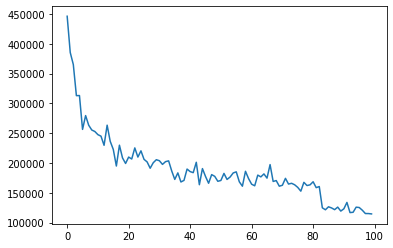

In [25]:
metric = utils.MetricCallback(every=1)
model = Word2Vec(
    sentences=countries.values(),
    size=128,
    iter=100,
    max_vocab_size=65536,
    compute_loss=True,
    callbacks=[metric],
    min_alpha=0.001,
    workers=9
)
plt.plot(metric.myloss)

In [26]:
model.wv.most_similar('India')

[('Nepal', 0.6007941961288452),
 ('Pakistan', 0.5788396596908569),
 ('China', 0.5458465814590454),
 ('Singapore', 0.5431758165359497),
 ('Malaysia', 0.508400022983551),
 ('Bangladesh', 0.4977942705154419),
 ('Indonesia', 0.49391233921051025),
 ('Bengal', 0.479034423828125),
 ('Indian', 0.4705680310726166),
 ('Vietnam', 0.4633248746395111)]

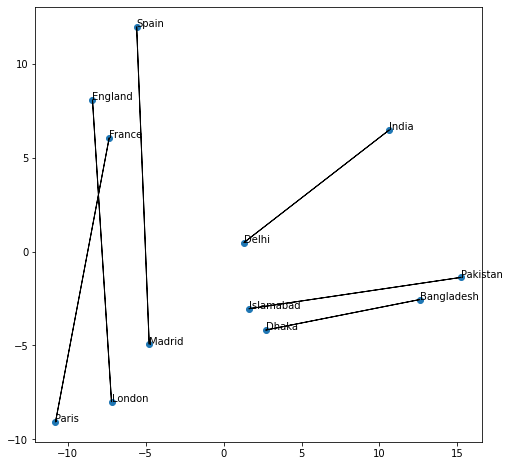

In [27]:
X = ['India', 'Pakistan', 'Bangladesh', 'France', 'England', 'Spain']
Y = ['Delhi', 'Islamabad', 'Dhaka', 'Paris', 'London', 'Madrid']
utils.plot_arrows(X, Y, model.wv)

In [28]:
model.wv.most_similar(positive=['Ganges', 'Brazil'], negative=['India'])

[('Putumayo', 0.4882325530052185),
 ('Plata', 0.47724953293800354),
 ('river', 0.46681469678878784),
 ('Río', 0.45166248083114624),
 ('Napo', 0.44122081995010376),
 ('Pastaza', 0.4354082942008972),
 ('Paraná', 0.42732909321784973),
 ('Lempa', 0.42645764350891113),
 ('Amazon', 0.40101099014282227),
 ('rivers', 0.3967113494873047)]

In [29]:
model.wv.most_similar(positive=['Washington', 'France'], negative=['America'])

[('Paris', 0.4500650465488434),
 ('1899', 0.416982501745224),
 ('UK', 0.4127674400806427),
 ('London', 0.40587276220321655),
 ('Accords', 0.36931467056274414),
 ('Arnold', 0.3673847019672394),
 ('Baptiste', 0.3661148250102997),
 ('Berlin', 0.36355453729629517),
 ('French', 0.35926124453544617),
 ('René', 0.35753923654556274)]

In [30]:
model.wv.most_similar(positive=['Hindi', 'Germany'], negative=['India'])

[('German', 0.45784375071525574),
 ('Salzburg', 0.4024409055709839),
 ('Péter', 0.3987361192703247),
 ('Austrians', 0.3952347934246063),
 ('Liszt', 0.392534464597702),
 ('Bernhard', 0.3913865387439728),
 ('und', 0.38692814111709595),
 ('Georg', 0.38167881965637207),
 ('Gerhard', 0.37792903184890747),
 ('Sándor', 0.37660112977027893)]

In [31]:
model.save('wiki-countries.w2v')

In [32]:
from gensim.models import KeyedVectors
model = KeyedVectors.load('wiki-countries.w2v')

In [33]:
model